In [1]:
import numpy as np
import copy

import neal

# Problem modelling imports
from docplex.mp.model import Model

# Qiskit imports
from qiskit import Aer
from qiskit.algorithms import QAOA, NumPyMinimumEigensolver
from qiskit.algorithms.optimizers import COBYLA
from qiskit.primitives import Sampler
from qiskit.utils.algorithm_globals import algorithm_globals
from qiskit_optimization.algorithms import MinimumEigenOptimizer, CplexOptimizer
from qiskit_optimization import QuadraticProgram
from qiskit_optimization.problems.variable import VarType
from qiskit_optimization.converters.quadratic_program_to_qubo import QuadraticProgramToQubo
from qiskit_optimization.translators import from_docplex_mp 

import rustworkx
import matplotlib.pyplot as plt
from rustworkx.visualization import mpl_draw

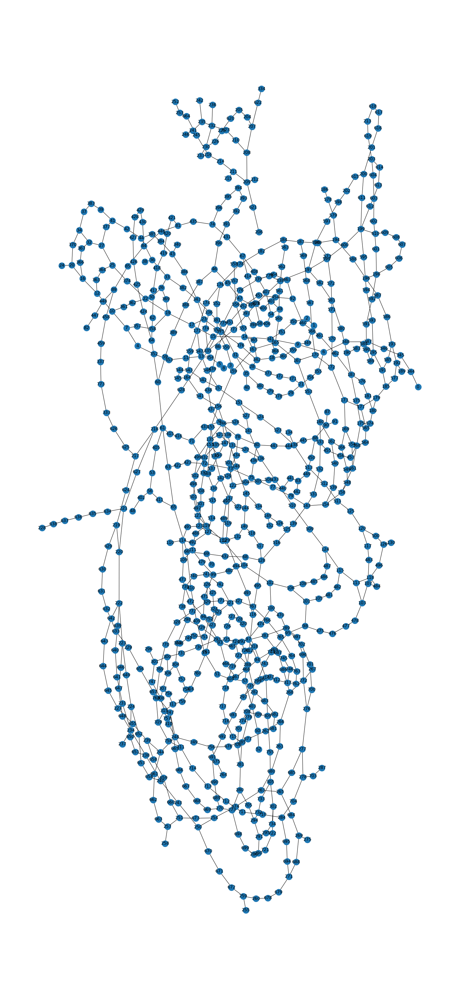

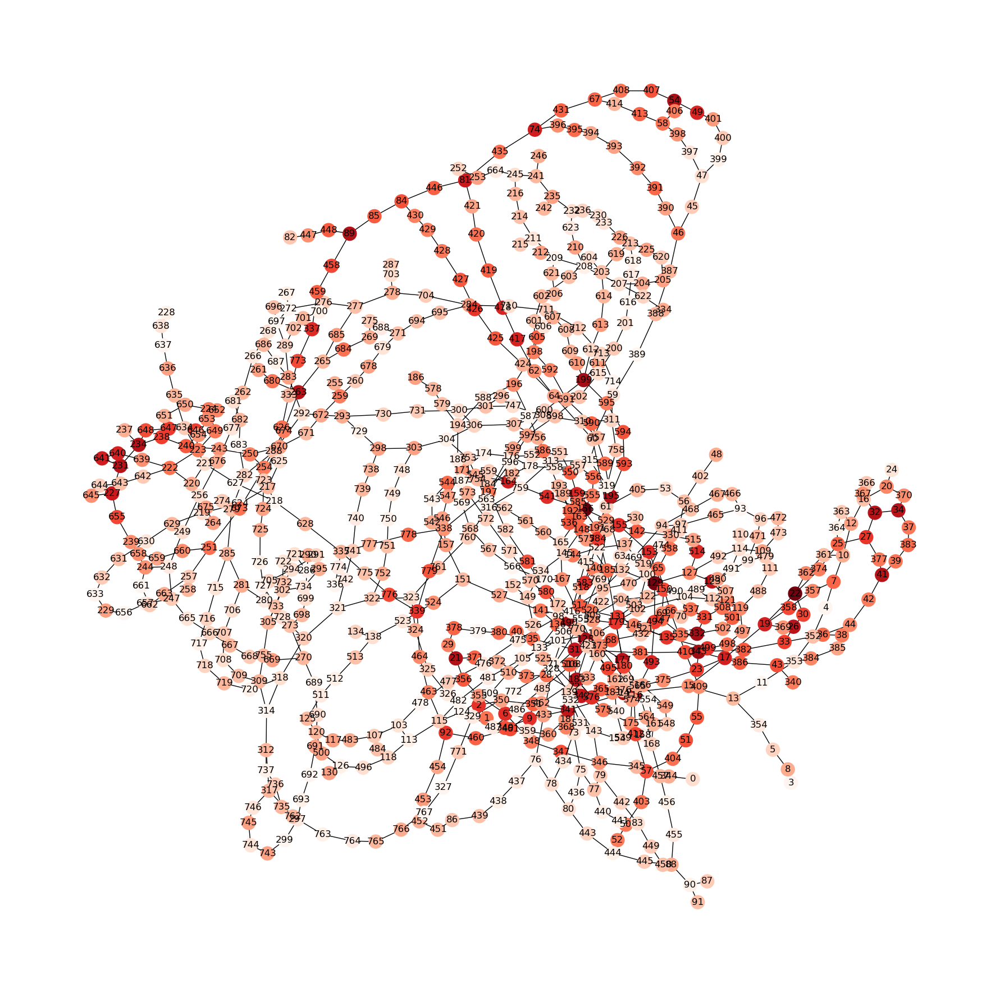

In [2]:
import rustworkx
import matplotlib.pyplot as plt
from rustworkx.visualization import mpl_draw
import pandas as pd
import random

data = pd.read_csv("/Users/tuktuktaxi/Desktop/pipe_data.csv")
data1 = pd.read_csv("/Users/tuktuktaxi/Desktop/node_data.csv")

#print(data.columns)

#convert columns into a list
node_a = list(data["start_node"])
node_b = list(data["end_node"])
length = list(data["length(m)"])

node_name = list(data1["node"])
node_f = list(data1["f"])
node_g = list(data1["g"])

graph = rustworkx.PyGraph()

name2index = {}
used_nodes = []
count = 0

for i in range (0, len(node_name)):
  #print(node_name[i])
  #name = str(node_name[i])
  name2index[node_name[i]] = graph.add_node({"name" : node_name[i], "f" : node_f[i], "g" : node_g[i]})



for i in range(0, len(node_a)):
  #print(node_a[i])
  graph.add_edge( name2index[node_a[i]] , name2index[node_b[i]] ,length[i] )

plt.figure(figsize=(50,50))
subax1 = plt.subplot(122)
mpl_draw(graph, with_labels=True, ax=subax1)

node_values = []

for i in range(len(graph.node_indices())):
  node_values.append(graph[i]['f']*15)

min_value = min(node_values)
max_value = max(node_values)
node_colors = [(value - min_value) / (max_value - min_value) for value in node_values]

base_color = (0.2, 0.2, 1.0)


#Our graph with weighted population densities at each node
plt.figure(figsize=(50,50))
subax1 = plt.subplot(222)
mpl_draw(graph, with_labels=True, node_color=node_colors, cmap=plt.cm.Reds)


In [5]:
#Formulating and solving a Hamiltonian from a given rustworkx graph#
from pyqubo import Binary
from pyqubo import Array
from pprint import pprint
import neal
from dwave.system import DWaveSampler, EmbeddingComposite, DWaveCliqueSampler, LeapHybridSampler
#create an array of binary variables in our Hamiltonian. 
#x[i] = 1 if a sensor is placed at that node, 0 otherwise

nodeIndices = graph.node_indices()

x = Array.create('x', shape=(len(nodeIndices)), vartype='BINARY')

#####calculate H_1#####
H_1 = 0
weight_max = None 

for edge in graph.edge_list():
  weight = graph.get_edge_data(*edge)

  if weight_max is None or weight > weight_max:
    weight_max = weight

  H_1 += (1-x[edge[0]])*(1-x[edge[1]])*weight

H_1 *= 1/weight_max

#####calculate H_2#####
H_2 = 0

for i in range(len(nodeIndices)):
  cost = graph[i]["f"] + graph[i]["g"]
  H_2 += x[i]*cost

#####calculate H_3#####

#number of sensors we want
sensors = 32
H_3 = (sum(x)-sensors)**2

#####Get Hamiltonian function#####
A,B,C = 83,65,738 
H = A*H_1 + B*H_2 + C*H_3

#Compile the Hamiltonian to get a model
model = H.compile()

#get and print QUBO coefficients
qubo, offset = model.to_qubo()

In [6]:
#D-Wave
bqm = model.to_bqm()
sa = LeapHybridSampler(token="DEV-5add07846ba6a4bf2a77ca6d3dda75c8c2b5306d")
sampleset = sa.sample(bqm)

decoded_samples = model.decode_sampleset(sampleset)
best_sample = min(decoded_samples, key=lambda x: x.energy)

#print the best sample
#output indicates at what xith node there should be a sensor. 0 indicates no sensor, 1 indicates a sensor. The number of sensors exactly match the number of sensors inputted by the engineer
print("Printing the best sample:")
pprint(best_sample.sample)


Printing the best sample:
{'x[0]': 0,
 'x[100]': 0,
 'x[101]': 1,
 'x[102]': 0,
 'x[103]': 0,
 'x[104]': 0,
 'x[105]': 0,
 'x[106]': 0,
 'x[107]': 0,
 'x[108]': 0,
 'x[109]': 0,
 'x[10]': 0,
 'x[110]': 0,
 'x[111]': 0,
 'x[112]': 0,
 'x[113]': 0,
 'x[114]': 0,
 'x[115]': 0,
 'x[116]': 0,
 'x[117]': 0,
 'x[118]': 0,
 'x[119]': 0,
 'x[11]': 0,
 'x[120]': 0,
 'x[121]': 0,
 'x[122]': 0,
 'x[123]': 0,
 'x[124]': 1,
 'x[125]': 0,
 'x[126]': 0,
 'x[127]': 0,
 'x[128]': 0,
 'x[129]': 0,
 'x[12]': 0,
 'x[130]': 0,
 'x[131]': 0,
 'x[132]': 0,
 'x[133]': 0,
 'x[134]': 0,
 'x[135]': 0,
 'x[136]': 0,
 'x[137]': 0,
 'x[138]': 0,
 'x[139]': 0,
 'x[13]': 0,
 'x[140]': 0,
 'x[141]': 0,
 'x[142]': 0,
 'x[143]': 0,
 'x[144]': 0,
 'x[145]': 0,
 'x[146]': 0,
 'x[147]': 0,
 'x[148]': 0,
 'x[149]': 0,
 'x[14]': 0,
 'x[150]': 0,
 'x[151]': 0,
 'x[152]': 0,
 'x[153]': 0,
 'x[154]': 1,
 'x[155]': 0,
 'x[156]': 0,
 'x[157]': 0,
 'x[158]': 0,
 'x[159]': 0,
 'x[15]': 0,
 'x[160]': 0,
 'x[161]': 0,
 'x[162]': 0,
 '

In [8]:
import numpy as np
def create_problem(weights, nodes) -> QuadraticProgram:
    total: int = 3
    iterations = int(nodes*0.5*nodes)
    result = []
    mdl = Model()
    dummy = 0
    x = [mdl.binary_var("x%s" % i) for i in range(nodes)]
    used = []

    for i in range(len(x)):
      print(x[i])

    print(weights)
    
    print(len(weights))
    results = []

    for name,value in weights.items():
      print(name,value)
      print(name[0][2], name[1][2])
      print( x[int(name[0][2])], x[int(name[1][2])] )

    objective = mdl.sum(x)
    mdl.minimize(objective)
    cost = (mdl.sum(x))
    #mdl.add_constraint(cost == total)

    qp = from_docplex_mp(mdl)
    return qp

#weights = qubo_ordered
weights2 = [1, 2, 3, 4, 5]

weight = qubo

q = create_problem(weight, len(graph.node_indices()))
print(q.prettyprint())


x0
x1
x2
x3
x4
x5
x6
x7
x8
x9
x10
x11
x12
x13
x14
x15
x16
x17
x18
x19
x20
x21
x22
x23
x24
x25
x26
x27
x28
x29
x30
x31
x32
x33
x34
x35
x36
x37
x38
x39
x40
x41
x42
x43
x44
x45
x46
x47
x48
x49
x50
x51
x52
x53
x54
x55
x56
x57
x58
x59
x60
x61
x62
x63
x64
x65
x66
x67
x68
x69
x70
x71
x72
x73
x74
x75
x76
x77
x78
x79
x80
x81
x82
x83
x84
x85
x86
x87
x88
x89
x90
x91
x92
x93
x94
x95
x96
x97
x98
x99
x100
x101
x102
x103
x104
x105
x106
x107
x108
x109
x110
x111
x112
x113
x114
x115
x116
x117
x118
x119
x120
x121
x122
x123
x124
x125
x126
x127
x128
x129
x130
x131
x132
x133
x134
x135
x136
x137
x138
x139
x140
x141
x142
x143
x144
x145
x146
x147
x148
x149
x150
x151
x152
x153
x154
x155
x156
x157
x158
x159
x160
x161
x162
x163
x164
x165
x166
x167
x168
x169
x170
x171
x172
x173
x174
x175
x176
x177
x178
x179
x180
x181
x182
x183
x184
x185
x186
x187
x188
x189
x190
x191
x192
x193
x194
x195
x196
x197
x198
x199
x200
x201
x202
x203
x204
x205
x206
x207
x208
x209
x210
x211
x212
x213
x214
x215
x216
x217
x218
x219
x220
x221


In [12]:
result = CplexOptimizer().solve(q)
print(result.prettyprint())

objective function value: 0.0
variable values: x0=0, x1=0, x2=0, x3=0, x4=0, x5=0, x6=0, x7=0, x8=0, x9=0, x10=0, x11=0, x12=0, x13=0, x14=0, x15=0, x16=0, x17=0, x18=0, x19=0, x20=0, x21=0, x22=0, x23=0, x24=0, x25=0, x26=0, x27=0, x28=0, x29=0, x30=0, x31=0, x32=0, x33=0, x34=0, x35=0, x36=0, x37=0, x38=0, x39=0, x40=0, x41=0, x42=0, x43=0, x44=0, x45=0, x46=0, x47=0, x48=0, x49=0, x50=0, x51=0, x52=0, x53=0, x54=0, x55=0, x56=0, x57=0, x58=0, x59=0, x60=0, x61=0, x62=0, x63=0, x64=0, x65=0, x66=0, x67=0, x68=0, x69=0, x70=0, x71=0, x72=0, x73=0, x74=0, x75=0, x76=0, x77=0, x78=0, x79=0, x80=0, x81=0, x82=0, x83=0, x84=0, x85=0, x86=0, x87=0, x88=0, x89=0, x90=0, x91=0, x92=0, x93=0, x94=0, x95=0, x96=0, x97=0, x98=0, x99=0, x100=0, x101=0, x102=0, x103=0, x104=0, x105=0, x106=0, x107=0, x108=0, x109=0, x110=0, x111=0, x112=0, x113=0, x114=0, x115=0, x116=0, x117=0, x118=0, x119=0, x120=0, x121=0, x122=0, x123=0, x124=0, x125=0, x126=0, x127=0, x128=0, x129=0, x130=0, x131=0, x132=0,

In [13]:
#Not runnable at this scale with any gate based optimzer, due to lack of qubits
algorithm_globals.random_seed = 12345

sampler = Aer.get_backend('aer_simulator')

qaoa_mes = QAOA(optimizer=COBYLA(), initial_point=[0.0, 1.0], quantum_instance=sampler)
exact_mes = NumPyMinimumEigensolver()

qaoa = MinimumEigenOptimizer(qaoa_mes)

qaoa_result = qaoa.solve(q)

print(qaoa_result)